### Description :
This dataset contains a comprehensive list of the most famous songs of 2023 as listed on Spotify. The dataset offers a wealth of features beyond what is typically available in similar datasets. It provides insights into each song's attributes, popularity, and presence on various music platforms. The dataset includes information such as track name, artist(s) name, release date, Spotify playlists and charts, streaming statistics, Apple Music presence, Deezer presence, Shazam charts, and various audio features.

### Key Features:
track_name: Name of the song  
artist(s)_name: Name of the artist(s) of the song  
artist_count: Number of artists contributing to the song  
released_year: Year when the song was released  
released_month: Month when the song was released  
released_day: Day of the month when the song was released  
in_spotify_playlists: Number of Spotify playlists the song is included in  
in_spotify_charts: Presence and rank of the song on Spotify charts  
streams: Total number of streams on Spotify  
in_apple_playlists: Number of Apple Music playlists the song is included in  
in_apple_charts: Presence and rank of the song on Apple Music charts  
in_deezer_playlists: Number of Deezer playlists the song is included in  
in_deezer_charts: Presence and rank of the song on Deezer charts  
in_shazam_charts: Presence and rank of the song on Shazam charts  
bpm: Beats per minute, a measure of song tempo  
key: Key of the song  
mode: Mode of the song (major or minor)  
danceability_%: Percentage indicating how suitable the song is for dancing  
valence_%: Positivity of the song's musical content  
energy_%: Perceived energy level of the song  
acousticness_%: Amount of acoustic sound in the song  
instrumentalness_%: Amount of instrumental content in the song  
liveness_%: Presence of live performance elements  
speechiness_%: Amount of spoken words in the song  
Link to the description: https://www.kaggle.com/datasets/nelgiriyewithana/top-spotify-songs-2023  ces.

### Potential Use Cases:
Music analysis: Explore patterns in audio features to understand trends and preferences in popular songs.  
Platform comparison: Compare the song's popularity across different music platforms.  
Artist impact: Analyze how artist involvement and attributes relate to a song's success.    
Temporal trends: Identify any shifts in music attributes and preferences over time.  
Cross-platform presence: Investigate how songs perform across different streaming services. 

In [1]:
import pandas as pd
import numpy as np
import dataprep
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
spotify = pd.read_csv('spotify-2023.csv')
spotify.head()

,track_name,artist(s)_name,artist_count,released_year,released_month,released_day,in_spotify_playlists,in_spotify_charts,streams,in_apple_playlists,...,bpm,key,mode,danceability_%,valence_%,energy_%,acousticness_%,instrumentalness_%,liveness_%,speechiness_%
0,Seven (feat. Latto) (Explicit Ver.),"Latto, Jung Kook",2,2023,7,14,553,147,141381703,43,...,125,B,Major,80,89,83,31,0,8,4
1,LALA,Myke Towers,1,2023,3,23,1474,48,133716286,48,...,92,C#,Major,71,61,74,7,0,10,4
2,vampire,Olivia Rodrigo,1,2023,6,30,1397,113,140003974,94,...,138,F,Major,51,32,53,17,0,31,6
3,Cruel Summer,Taylor Swift,1,2019,8,23,7858,100,800840817,116,...,170,A,Major,55,58,72,11,0,11,15
4,WHERE SHE GOES,Bad Bunny,1,2023,5,18,3133,50,303236322,84,...,144,A,Minor,65,23,80,14,63,11,6


In [3]:
spotify.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 952 entries, 0 to 951
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   track_name            952 non-null    object
 1   artist(s)_name        952 non-null    object
 2   artist_count          952 non-null    int64 
 3   released_year         952 non-null    int64 
 4   released_month        952 non-null    int64 
 5   released_day          952 non-null    int64 
 6   in_spotify_playlists  952 non-null    int64 
 7   in_spotify_charts     952 non-null    int64 
 8   streams               952 non-null    int64 
 9   in_apple_playlists    952 non-null    int64 
 10  in_apple_charts       952 non-null    int64 
 11  in_deezer_playlists   952 non-null    object
 12  in_deezer_charts      952 non-null    int64 
 13  in_shazam_charts      902 non-null    object
 14  bpm                   952 non-null    int64 
 15  key                   857 non-null    ob

In [4]:
# Column in Shazam chart is mistaken as object --> change to numeric
spotify['in_shazam_charts'] = pd.to_numeric(spotify['in_shazam_charts'], errors='coerce')

In [5]:
# Column in in_deezer_playlists is mistaken as object --> change to numeric
spotify['in_deezer_playlists'] = pd.to_numeric(spotify['in_deezer_playlists'], errors='coerce')

In [6]:
spotify.describe()

,artist_count,released_year,released_month,released_day,in_spotify_playlists,in_spotify_charts,streams,in_apple_playlists,in_apple_charts,in_deezer_playlists,in_deezer_charts,in_shazam_charts,bpm,danceability_%,valence_%,energy_%,acousticness_%,instrumentalness_%,liveness_%,speechiness_%
count,952.000000,952.000000,952.000000,952.000000,952.000000,952.000000,9.520000e+02,952.000000,952.000000,873.000000,952.000000,895.000000,952.000000,952.000000,952.000000,952.000000,952.000000,952.000000,952.000000,952.000000
mean,1.556723,2018.288866,6.038866,13.944328,5202.565126,12.022059,5.141374e+08,67.866597,51.963235,109.804124,2.669118,51.233520,122.553571,66.984244,51.406513,64.274160,27.078782,1.582983,18.214286,10.138655
std,0.893331,11.011397,3.564571,9.197223,7901.400683,19.582405,5.668569e+08,86.470591,50.628850,178.903937,6.038152,126.546992,28.069601,14.631282,23.480526,16.558517,26.001599,8.414064,13.718374,9.915399
min,1.000000,1930.000000,1.000000,1.000000,31.000000,0.000000,2.762000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,65.000000,23.000000,4.000000,9.000000,0.000000,0.000000,3.000000,2.000000
25%,1.000000,2020.000000,3.000000,6.000000,874.500000,0.000000,1.416362e+08,13.000000,7.000000,12.000000,0.000000,0.000000,99.750000,57.000000,32.000000,53.000000,6.000000,0.000000,10.000000,4.000000
50%,1.000000,2022.000000,6.000000,13.000000,2216.500000,3.000000,2.905309e+08,34.000000,38.500000,36.000000,0.000000,2.000000,121.000000,69.000000,51.000000,66.000000,18.000000,0.000000,12.000000,6.000000
75%,2.000000,2022.000000,9.000000,22.000000,5573.750000,16.000000,6.738690e+08,88.000000,87.000000,110.000000,2.000000,36.000000,140.250000,78.000000,70.000000,77.000000,43.000000,0.000000,24.000000,11.000000
max,8.000000,2023.000000,12.000000,31.000000,52898.000000,147.000000,3.703895e+09,672.000000,275.000000,974.000000,58.000000,953.000000,206.000000,96.000000,97.000000,97.000000,97.000000,91.000000,97.000000,64.000000


In [7]:
# EDA
from dataprep.eda import create_report, plot

  0%|                                                                                         | 0/4503 [00:00<…

C:\Users\PC\Software\miniconda\envs\mynewenv\lib\site-packages\dask\core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\PC\Software\miniconda\envs\mynewenv\lib\site-packages\dask\core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\PC\Software\miniconda\envs\mynewenv\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\PC\Software\miniconda\envs\mynewenv\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"

DataPrep Report
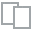
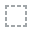
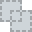
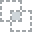
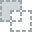
...
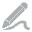
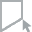
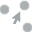
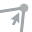
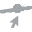

In [8]:
# REPORT of DATA
report = create_report(spotify)
report

### EDA Comments
artist_count: Large amount of artists appear on this Spotify dataset in 2023 once

released_year: A lot of songs were released around 2021-2023

released_month: The most selected songs released in January and May

released_day: Most songs released at the beginning of the month (1st day)

in_spotify_playlists: The largest number of songs in the dataset are added to between 31 and 1088 Spotify playlists, indicating moderate popularity.

in_spotify_charts: There are 404 zeros in this variable. This could be possible because some songs didn't make it into the charts.

streams: The number of most popular streams is between 74 mil to 149 mil. Maximum is 3,703,895,074 streams.

in_apple_playlists: there are 23 zeros in this variable. This could be possible because there could be songs that didn't make it into any playlists.

in_apple_charts: there are 99 zeros in this variable. This could be possible because there could be songs that didn't make it into the charts.

in_deezer_playlists: 
- There are 24 zeros in this variable. This could be possible because there could be songs that didn't make it into any playlists.
- There are 79 missing (8.3%) --> may leave it be, because not intend to include this in the analysis 

in_deezer_charts: There are 557 zeros in this variable. This could be possible because there could be songs that didn't make it into the charts.

in_shazam_charts: 
- There are 343 zeros in this variable. This could be possible because there could be songs that didn't make it into any playlists.
- There are 57 missing (6%) --> may leave it be, because not intend to include this into the analysis

bpm: there are 1-2 distributions

key: There are 95 missing (10%). why songs have no key? should I write over the mean or median of this? Or leave it because the number of missing is not too large 

mode: There are more songs in major. However, the gap is just around 100 songs.

danceability_%: The dataset is left-skewed. It indicates that most of the famous songs have a high percentage of danceability (suitable for dancing) valence_%: has 2 distributions. Lots of famous songs may have high (around 50%) or not so high (around 20-22%) percentage of valence. Famous songs can be happy, joyful or slow.

energy_%: The dataset is left-skewed. It indicates that most of the famous songs have a high percentage of energy (high Perceived energy level) 
acousticness_%: 
- There are 60 zeros in this variable. Could be some songs that don't have any acoustic sound at all.
- The dataset is heavily right-skewed. It indicates that most of the famous songs have a low percentage of acousticness 

instrumentalness_%: 
- There are 865 (90%) zeros in this variable. May leave out this variable since it missed too much.

liveness_%: The dataset is heavily right-skewed. It indicates that most of the famous songs have a low percentage of liveness (Presence of live performance elements) 

speechiness_%: The dataset is heavily right-skewed. It indicates that most of the famous songs have a low percentage of speechiness (Amount of spoken words in the song)

### What (may) need to be done
key: do I need to write over the mean or median of this variable (95 missing)  
Do not add the instrumentalness_% variable to the analysis because it misses too many

In [9]:
spotify.columns

Index(['track_name', 'artist(s)_name', 'artist_count', 'released_year',
       'released_month', 'released_day', 'in_spotify_playlists',
       'in_spotify_charts', 'streams', 'in_apple_playlists', 'in_apple_charts',
       'in_deezer_playlists', 'in_deezer_charts', 'in_shazam_charts', 'bpm',
       'key', 'mode', 'danceability_%', 'valence_%', 'energy_%',
       'acousticness_%', 'instrumentalness_%', 'liveness_%', 'speechiness_%'],
      dtype='object')

In [10]:
# categorical data
spotify.select_dtypes(include='object').columns

Index(['track_name', 'artist(s)_name', 'key', 'mode'], dtype='object')

In [11]:
col_cat = ['track_name', 'artist(s)_name', 'key', 'mode']

In [12]:
# numeric data
spotify.select_dtypes(include='float' and 'int').columns

Index(['artist_count', 'released_year', 'released_month', 'released_day',
       'in_spotify_playlists', 'in_spotify_charts', 'streams',
       'in_apple_playlists', 'in_apple_charts', 'in_deezer_charts', 'bpm',
       'danceability_%', 'valence_%', 'energy_%', 'acousticness_%',
       'instrumentalness_%', 'liveness_%', 'speechiness_%'],
      dtype='object')

In [13]:
col_num = ['artist_count', 'released_year', 'released_month', 'released_day',
       'in_spotify_playlists', 'in_spotify_charts', 'streams',
       'in_apple_playlists', 'in_apple_charts', 'in_deezer_charts', 'bpm',
       'danceability_%', 'valence_%', 'energy_%', 'acousticness_%', 'liveness_%', 'speechiness_%'] #bỏ instrumentalness_%

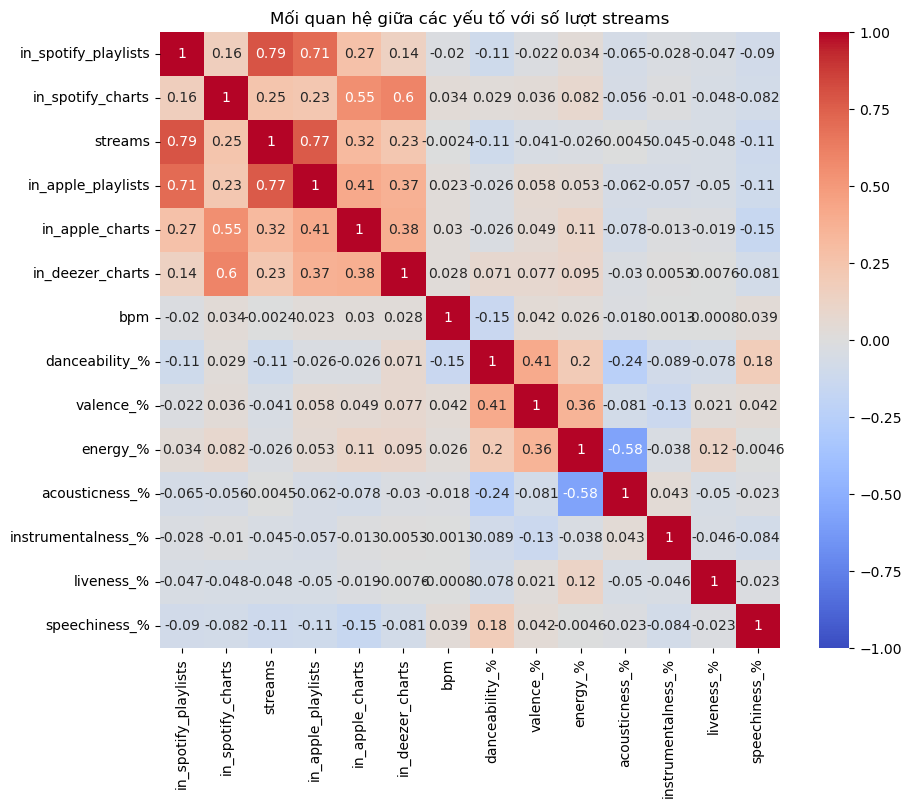

In [14]:
# Compute the correlation matrix
corr_matrix = spotify[[ 'in_spotify_playlists', 'in_spotify_charts', 'streams',
       'in_apple_playlists', 'in_apple_charts', 'in_deezer_charts', 'bpm',
       'danceability_%', 'valence_%', 'energy_%', 'acousticness_%',
       'instrumentalness_%', 'liveness_%', 'speechiness_%']].corr()

# Plotting the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('The relationship between features and streams')
plt.savefig('The relationship between features and streams.png', format='png', dpi=1000)
plt.show()



## Corr heatmap key takeaways
bpm, danceability_%, valence_%, energy_%, acousticness_%, instrumentalness_%, liveness_%, and speechiness_% all have nearly 0 correlation with streams, it suggests that these musical attributes have little to no linear relationship with the number of streams a song receives.

### More specifically: 
- 'in_spotify_playlists' and 'in_apple_playlists' strongly influence the popularity of the songs in a positive way
- The streaming success of a song (measured by the number of streams) is not strongly influenced by whether the song has a high or low value in any of these attributes.
- Diverse listener preferences: Songs can be streamed heavily regardless of their tempo (bpm), danceability, mood (valence), energy, acoustic nature, or other features. This implies that listeners are streaming a wide variety of songs, not just those with specific musical characteristics.
- Other factors at play: Since these attributes don't correlate with streams, other factors (like artist popularity, marketing, playlist placements, cultural trends, etc.) might be more important in driving streams.

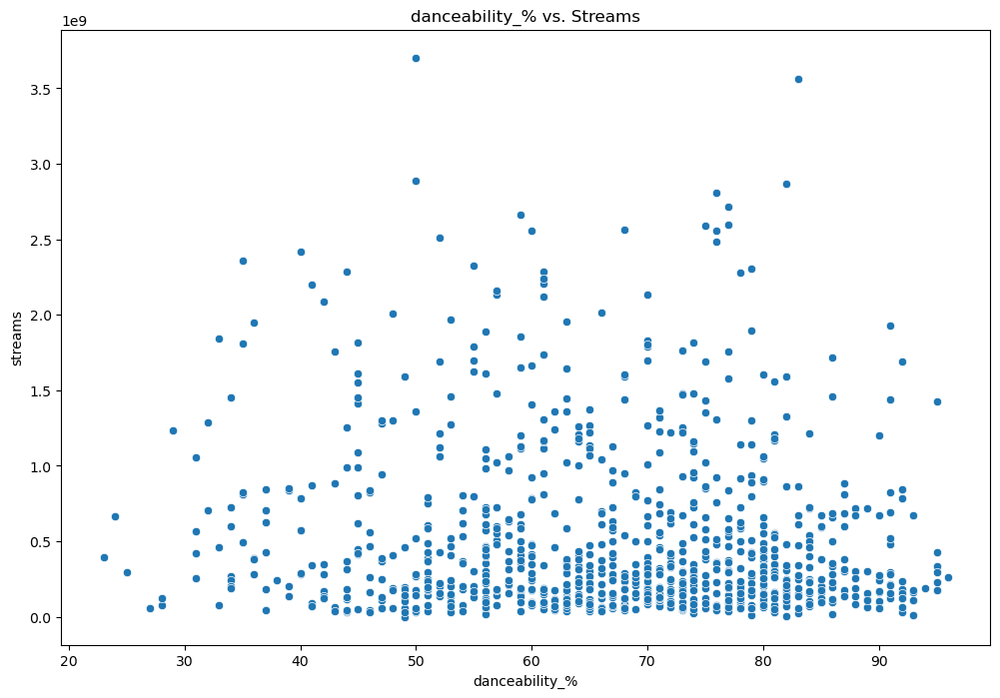

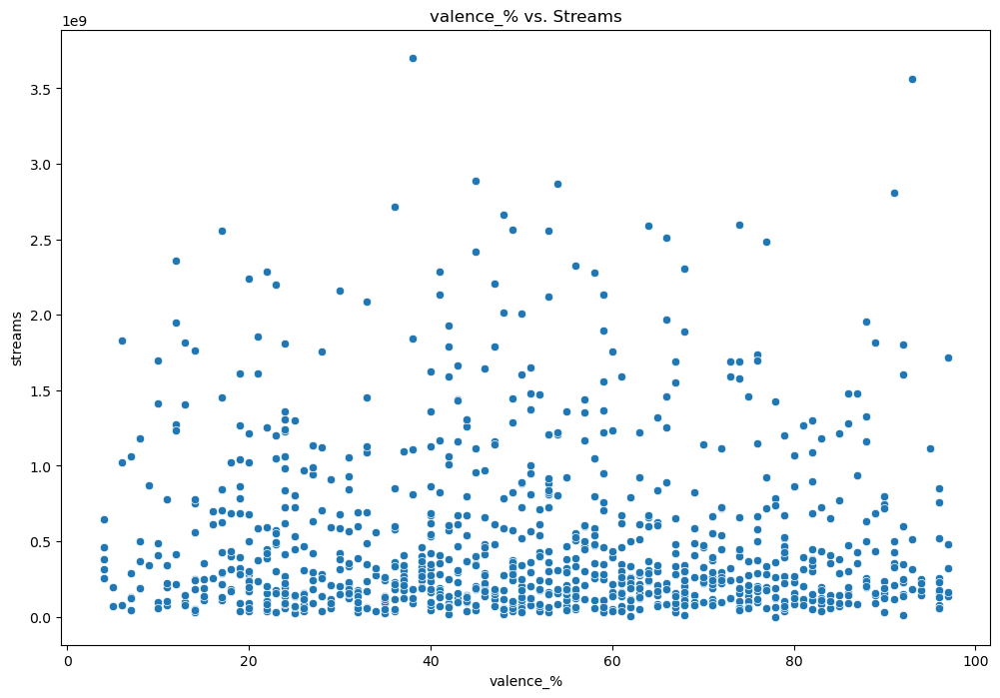

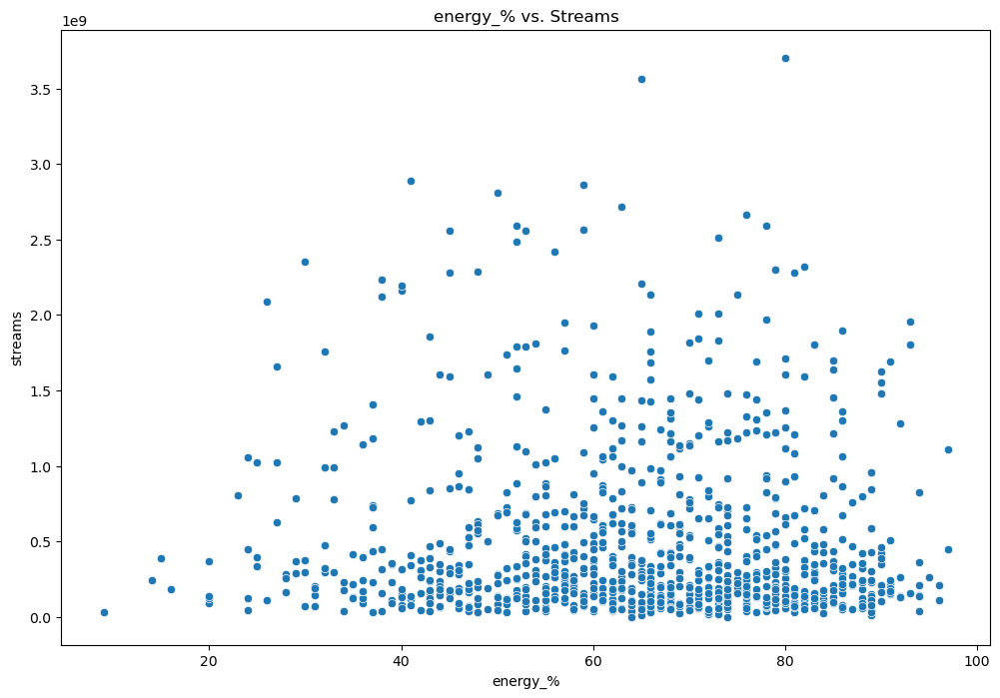

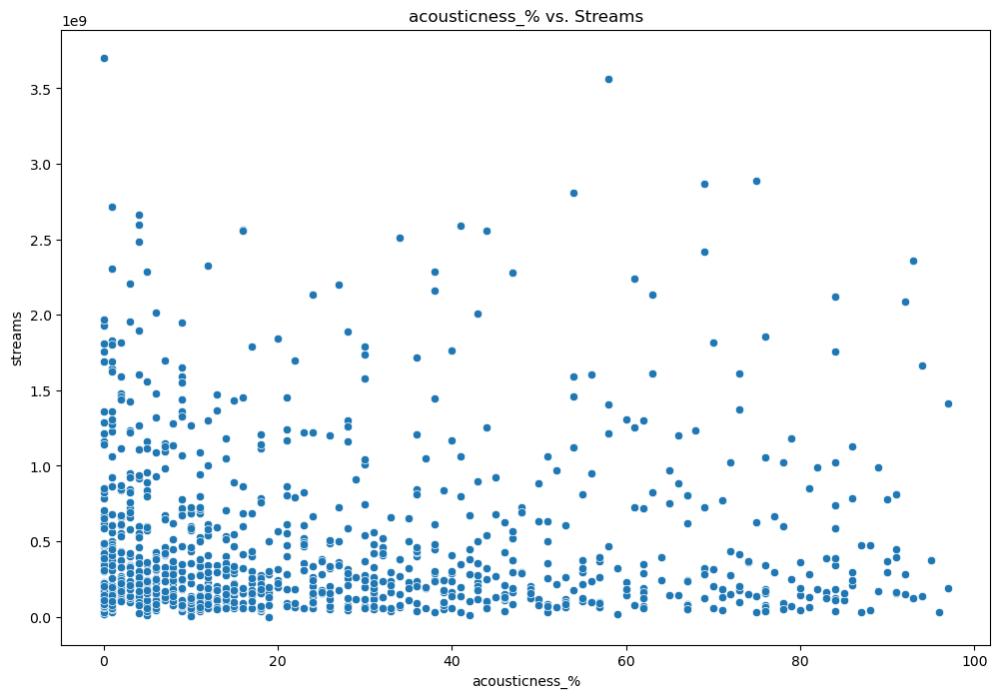

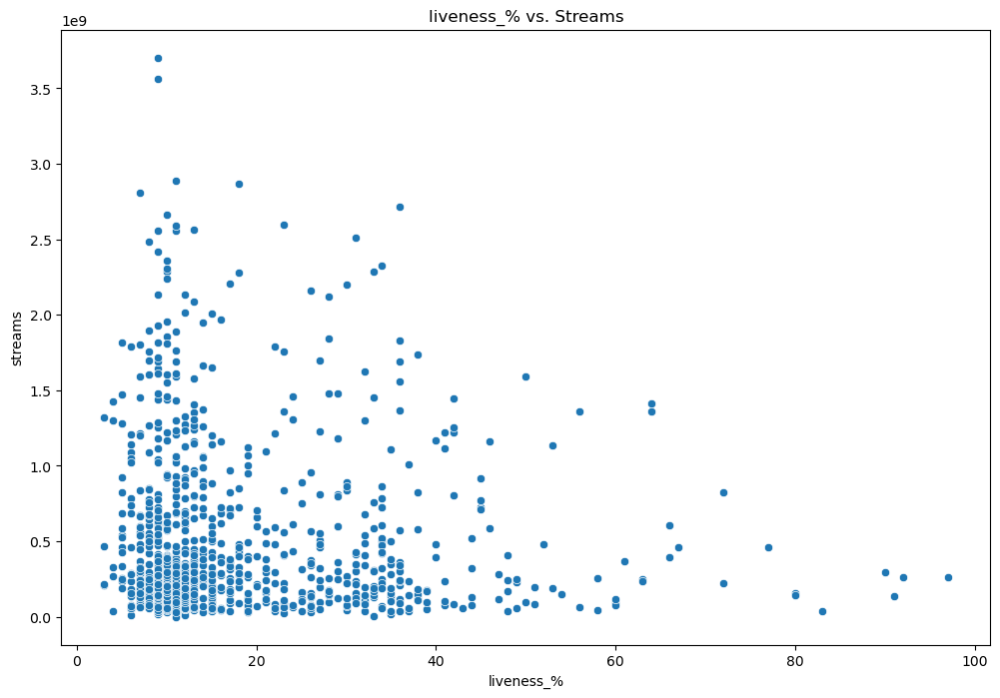

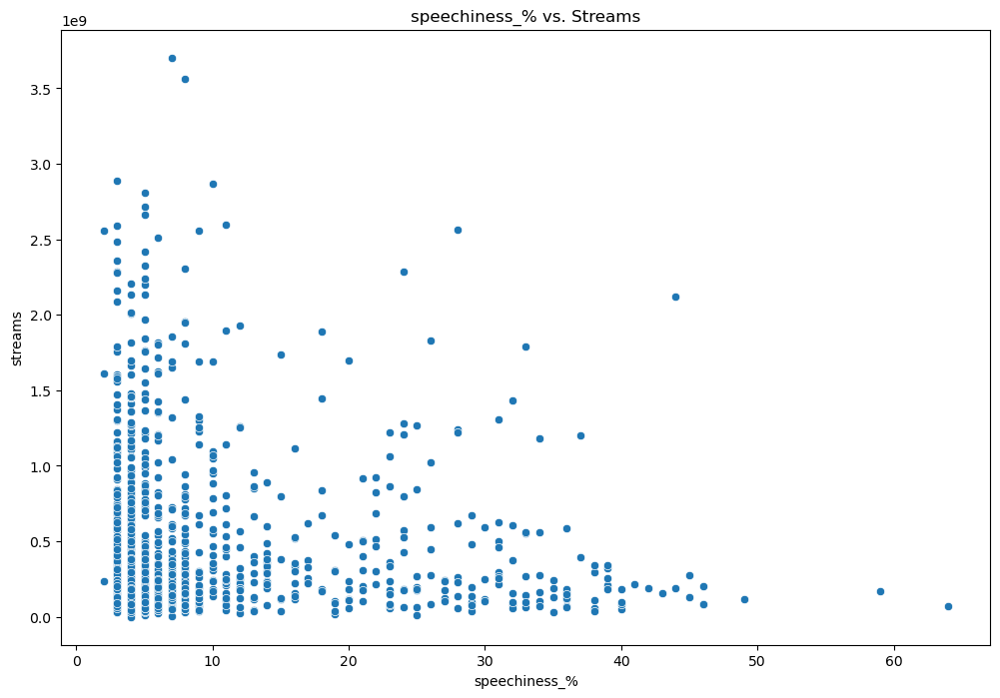

In [15]:
# Scatter plot for each feature compared to 'streams'
features = ['danceability_%', 'valence_%', 'energy_%', 'acousticness_%', 'liveness_%', 'speechiness_%']

for feature in features:
    plt.figure(figsize=(12, 8))
    sns.scatterplot(x=feature, y='streams', data=spotify)
    plt.title(f'{feature} vs. Streams')

       # Save each plot with a unique filename based on the feature name
    filename = f'{feature}_vs_streams.png'
    plt.savefig(filename, format='png', dpi=300)
    
    plt.show()
# 1e9 = 1,000,000,000 

## Scatter plot key takeaways
For most of the attributes, the plots locates mostly in the lower part of the charts:
- This strengthens the correlation heatmap. The songs were streamed with a diversity in tastes (especially for danceability_%, valence_%, energy_%)
- For 'acousticness_%', 'liveness_%' and 'speechiness_%', most of the popular songs don't have high percentage of those 3 attributes. Listeners are likely to opt for songs with low 'acousticness_%', 'liveness_%' and 'speechiness_%'.
- However, there are still songs with high percentage of the 2 (no speechiness) and are streamed highly (find the name of those songs). This could be a case study for niche genres.

In [16]:
# Define thresholds for "high percentage"
acousticness_threshold = 60
liveness_threshold = 60

# Define threshold for "high streams"
high_streams_threshold = spotify['streams'].quantile(0.75)

# find songs with high 'acousticness_%' and high streams
niche_songs = spotify[
    (spotify['acousticness_%'] > acousticness_threshold) &
    (spotify['streams'] > high_streams_threshold)
]

# Display these songs
niche_songs_list = niche_songs[['track_name', 'artist(s)_name', 'streams', 'acousticness_%']].sort_values(by='streams', ascending=False)
niche_songs_list

,track_name,artist(s)_name,streams,acousticness_%
86,Someone You Loved,Lewis Capaldi,2887241814,75
619,Dance Monkey,Tones and I,2864791672,69
324,Say You Won't Let Go,James Arthur,2420461338,69
128,lovely - Bonus Track,"Billie Eilish, Khalid",2355719893,93
760,Photograph,Ed Sheeran,2236667932,61
189,Take Me To Church,Hozier,2135158446,63
761,Love Yourself,Justin Bieber,2123309722,84
622,All of Me,John Legend,2086124197,92
535,drivers license,Olivia Rodrigo,1858144199,76
54,Another Love,Tom Odell,1813673666,70


In [17]:
# Filter the dataset to find songs with high 'liveness_%' and high streams
niche_songs = spotify[
    (spotify['liveness_%'] > liveness_threshold) &
    (spotify['streams'] > high_streams_threshold)
]

# Display the names of these songs
niche_songs_list = niche_songs[['track_name', 'artist(s)_name', 'streams', 'liveness_%']]
niche_songs_list

,track_name,artist(s)_name,streams,liveness_%
167,The Night We Met,Lord Huron,1410088830,64
331,Numb,Linkin Park,1361425037,64
432,Good Days,SZA,826623384,72


In [18]:
month_avg_streams = spotify.groupby('released_month')['streams'].mean().sort_values()
month_avg_streams

released_month
2     3.531535e+08
12    3.695734e+08
4     4.041460e+08
6     4.100447e+08
5     4.156691e+08
3     4.770526e+08
7     4.821765e+08
11    5.525923e+08
10    5.889024e+08
8     6.312657e+08
1     7.275061e+08
9     7.346444e+08
Name: streams, dtype: float64

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
C:\Users\PC\AppData\Local\Temp\ipykernel_4088\1577847590.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=month_avg_streams.index, y=month_avg_streams.values, palette='viridis')
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


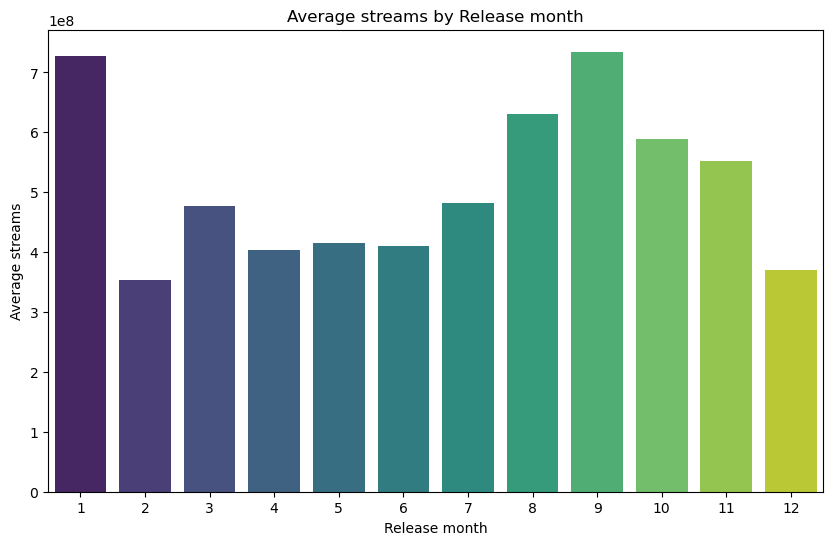

In [19]:
# Bar chart for 'released_month' vs average streams


plt.figure(figsize=(10, 6))
sns.barplot(x=month_avg_streams.index, y=month_avg_streams.values, palette='viridis')
plt.title('Average streams by Release month')
plt.xlabel('Release month')
plt.ylabel('Average streams')

plt.savefig('Average streams by release month.png', format='png', dpi=1000)

plt.show()

### Bar plot key takeaways
- Songs released in Jan & Sep tend to have more streams on average
- Conversely, songs released in Feb & Dec generally receive fewer streams on average.
- In the EDA section, songs are released mostly in Jan & May, but the most streamed here are in Jan & Sep